<a href="https://colab.research.google.com/github/Ananya1907/Approximate_Computing/blob/main/Approx_Computing_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Compressor

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from skimage import io, color, measure
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
import math
from PIL import Image
from scipy.fftpack import dct, idct
from numba import njit, int32

@njit
def XNOR(A, B):
  return (A == B)

@njit
def XOR(A, B):
  return (A ^ B)

@njit
def NOR(A, B):
  return (~(A | B))

@njit
def OR (A, B):
  return (A | B)

@njit
def AND (A, B):
  return (A & B)

@njit
def FA(A, B, C):
  temp = XOR(A, B)
  sum = XOR(temp, C)
  carry = OR(AND(temp, C), AND(A, B))
  return(carry, sum)

@njit
def HA(A, B):
  sum = XOR(A, B)
  carry = AND(A, B)
  return(carry, sum)

# ********************************COMPRESSOR************************************

@njit
def design2(A, B, C, D):
  carry = NOR(NOR(A, B), NOR(C, D))
  # Sum = OR(XNOR(A, B), XNOR(C, D))        # Paper design
  Sum = XOR(XNOR(A, B), XNOR(C, D))       # My design 1
  # Sum = XOR(XOR(A, B), XOR(C, D))         # My design 2
  return(carry, Sum)


## Multiplier

In [ ]:
@njit
def to_bin(x, n):
  bits = np.zeros(n, dtype = np.uint8)
  for i in range (n):
    bits[i] = (x >> i) & 1              # right shifts the binary representation of x by i bits and checks if the LSB is 1
  return (bits)

@njit
def mul2(A, B):
  n = 8
  A = int(A)
  B = int(B)
  sign = 1
  if(A < 0):
    sign *= -1
    A = -A
  if(B < 0):
    sign *= -1
    B = -B

  A = to_bin(A, n)
  B = to_bin(B, n)
  pp = np.zeros((n, n), dtype = np.uint8)
  m = np.zeros(16, dtype = np.int32)

  for i in range (n):
    for j in range (n):
      pp[i, j] = AND(A[j], B[i])

  # Stage 1
  p5c, p4 = HA(pp[0, 4], pp[1, 3])
  p6c, p5 = design2(pp[0, 5], pp[1, 4], pp[2, 3], pp[3, 2])
  p71c, p61 = design2(pp[0, 6], pp[1, 5], pp[2, 4], pp[3, 3])
  p72c, p62 = HA(pp[4, 2], pp[5, 1])
  p81c, p71 = design2(pp[0, 7], pp[1, 6], pp[2, 5], pp[3, 4])
  p82c, p72 = design2(pp[4, 3], pp[5, 2], pp[6, 1], pp[7, 0])
  p91c, p81 = design2(pp[1, 7], pp[2, 6], pp[3, 5], pp[4, 4])
  p92c, p82 = FA(pp[5, 3], pp[6, 2], pp[7, 1])
  p101c, p91 = design2(pp[2, 7], pp[3, 6], pp[4, 5], pp[5, 4])
  p102c, p92 = HA(pp[6, 3], pp[7, 2])
  p11c, p10 = design2(pp[3, 7], pp[4, 6], pp[5, 5], pp[6, 4])
  p12c, p11 = HA(pp[4, 7], pp[5, 6])

  # Stage 2
  c3, s2 = HA(pp[0, 2], pp[1, 1])
  c4, s3 = design2(pp[0, 3], pp[1, 2], pp[2, 1], pp[3, 0])
  c5, s4 = design2(p4, pp[2, 2], pp[3, 1], pp[4, 0])
  c6, s5 = design2(p5, p5c, pp[4, 1], pp[5, 0])
  c7, s6 = design2(p61, p62, p6c, pp[6, 0])
  c8, s7 = design2(p71, p72, p71c, p72c)
  c9, s8 = design2(p81, p82, p81c, p82c)
  c10, s9 = design2(p91, p92, p91c, p92c)
  c11, s10 = design2(p10, p101c, p102c, pp[7, 3])
  c12, s11 = design2(p11, p11c, pp[6, 5], pp[7, 4])
  c13, s12 = design2(p12c, pp[5, 7], pp[6, 6], pp[7, 5])
  c14, s13 = HA(pp[6, 7], pp[7, 6])

  # Addition Stage
  m[0] = pp[0, 0]
  C2, m[1] = HA(pp[0, 1], pp[1, 0])
  C3, m[2] = FA(s2, pp[2, 0], C2)
  C4, m[3] = FA(s3, c3, C3)
  C5, m[4] = FA(s4, c4, C4)
  C6, m[5] = FA(s5, c5, C5)
  C7, m[6] = FA(s6, c6, C6)
  C8, m[7] = FA(s7, c7, C7)
  C9, m[8] = FA(s8, c8, C8)
  C10, m[9] = FA(s9, c9, C9)
  C11, m[10] = FA(s10, c10, C10)
  C12, m[11] = FA(s11, c11, C11)
  C13, m[12] = FA(s12, c12, C12)
  C14, m[13] = FA(s13, c13, C13)
  m[15], m[14] = FA(pp[7, 7], c14, C14)

  result = 0
  for i in range (16):        # binary to int conversion
    result |= m[i] << i       # m[i] is placed in its correct position by left shifting it by i bits. It is then accumulated in result

  return (result * sign)


In [ ]:
A = int(input("A = "))
B = int(input("B = "))
print("Approx: ", mul2(A, B), "\tExact: ", A*B)

A = 12
B = 15
Approx:  68 	Exact:  180


## Convolution

In [ ]:
@njit
def convolution(img, kernel):
  height, width = img.shape
  k_height, k_width = kernel.shape
  pad = k_height // 2

  # Manual padding (replace np.pad)
  pad_img = np.zeros((height + 2*pad, width + 2*pad), dtype=np.int32)
  pad_img[pad:-pad, pad:-pad] = img             # Center
  # Fill borders (replicate edges)
  pad_img[:pad, pad:-pad] = img[0, :]           # Top
  pad_img[-pad:, pad:-pad] = img[-1, :]         # Bottom
  pad_img[:, :pad] = pad_img[:, pad:pad+1]      # Left
  pad_img[:, -pad:] = pad_img[:, -pad-1:-pad]   # Right

  # # Pad image
  # pad_img = np.pad(img.astype(np.int32), pad, mode = 'edge')

  output_approx = np.zeros_like(img, dtype = np.int32)
  output_exact = np.zeros_like(img, dtype = np.int32)

  # Convolution
  for y in range (height):
    for x in range (width):
      patch = pad_img[y:y+k_height, x:x+k_width]
      conv_sum_approx = 0
      conv_sum_exact = 0
      for ky in range (k_height):
        for kx in range (k_width):
          conv_sum_exact += (patch[ky, kx] * kernel[ky, kx])
          conv_sum_approx += mul2(patch[ky, kx], kernel[ky, kx])
      output_approx[y, x] = conv_sum_approx
      output_exact[y, x] = conv_sum_exact

  return (output_exact, output_approx)


## Edge Detection

In [ ]:
def edge_detect(img, Gx, Gy):
  gradx_exact, gradx_approx = convolution(img, Gx)
  grady_exact, grady_approx = convolution(img, Gy)

  # Compute gradient magnitude
  gradient_exact = np.sqrt(gradx_exact**2 + grady_exact**2)
  if(gradient_exact.max() > 0):
    gradient_exact = (gradient_exact / gradient_exact.max() * 255).astype(np.uint8)

  gradient_approx = np.sqrt(gradx_approx**2 + grady_approx**2)
  if(gradient_approx.max() > 0):
    gradient_approx = (gradient_approx / gradient_approx.max() * 255).astype(np.uint8)

  # Display
  plt.figure(figsize=(15, 10))
  plt.subplot(2, 2, 1)
  plt.imshow(img, cmap = 'gray')
  plt.title("Original Image")
  plt.axis('off')

  plt.subplot(2, 2, 2)
  difference = np.abs(gradient_exact.astype(np.float32) - gradient_approx.astype(np.float32))
  if(difference.min() != difference.max()):
    diff_normal = (difference - difference.min()) / (difference.max() - difference.min())   # Scale to [0, 1]
  else:
    diff_normal = np.clip(difference, 0, 1)
  plt.imshow(diff_normal, cmap='hot')
  plt.title("Difference Map")
  plt.axis('off')

  plt.subplot(2, 2, 3)
  plt.imshow(gradient_exact, cmap='gray')
  plt.title("Exact Edges")
  plt.axis('off')

  plt.subplot(2, 2, 4)
  plt.imshow(gradient_approx, cmap='gray')
  plt.title("Approx Edges")
  plt.axis('off')

  plt.tight_layout()
  plt.show()

  # Compute PSNR and SSIM
  psnr_val = psnr(gradient_exact, gradient_approx, data_range=255)
  ssim_val = ssim(gradient_exact, gradient_approx, data_range=255)

  return(psnr_val, ssim_val)


### Main Function

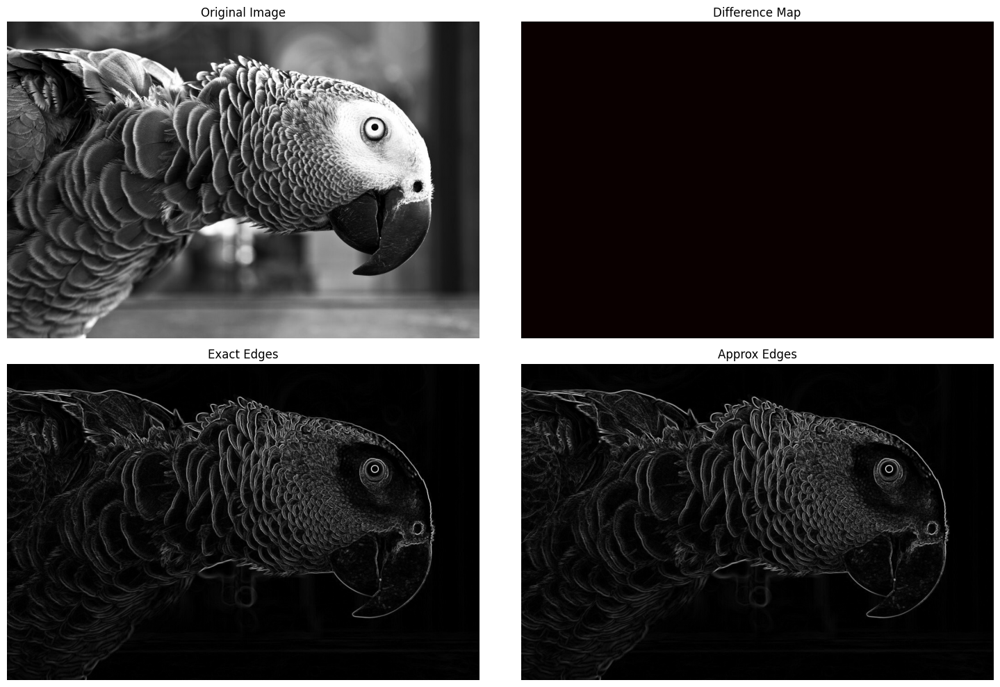

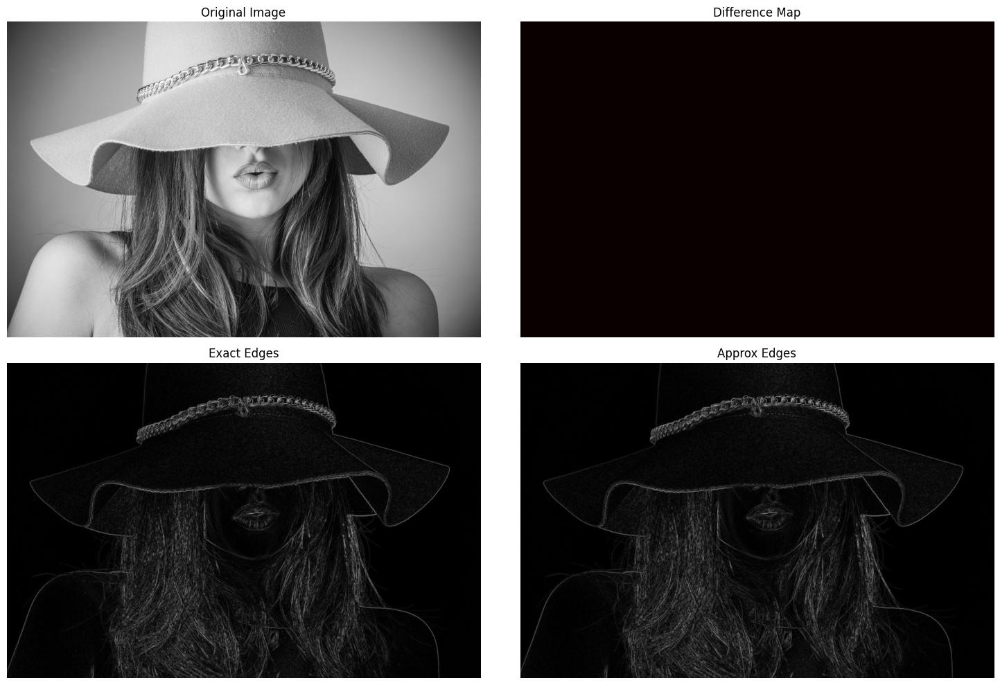

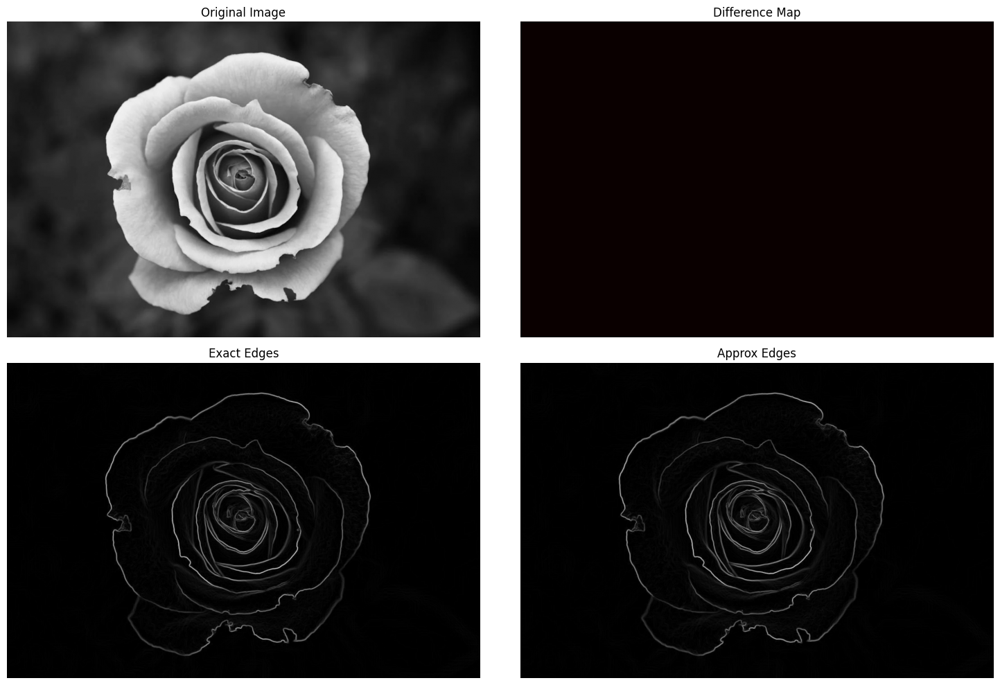

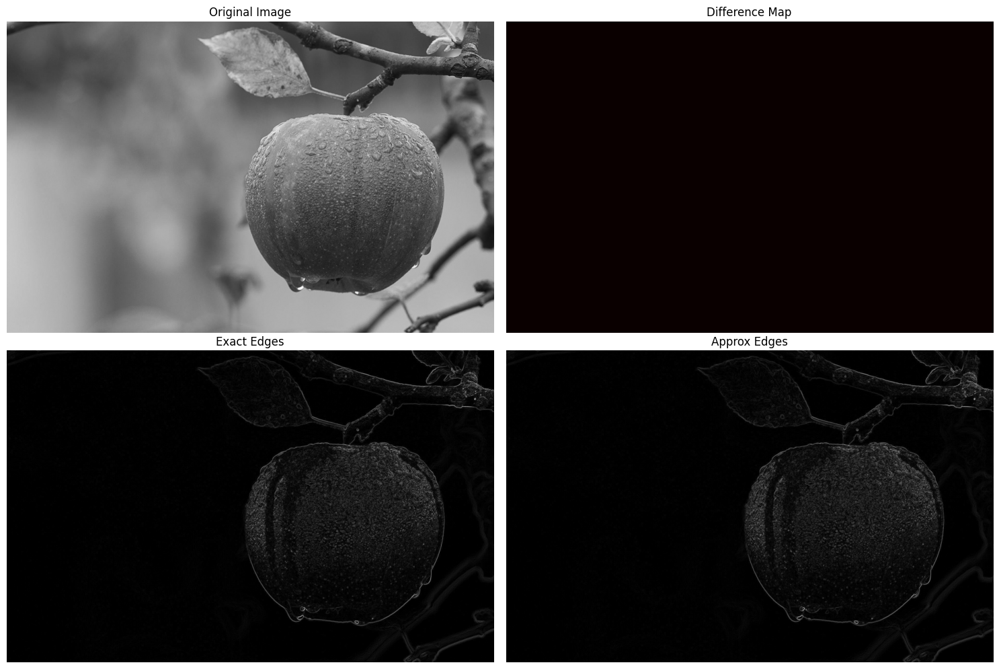

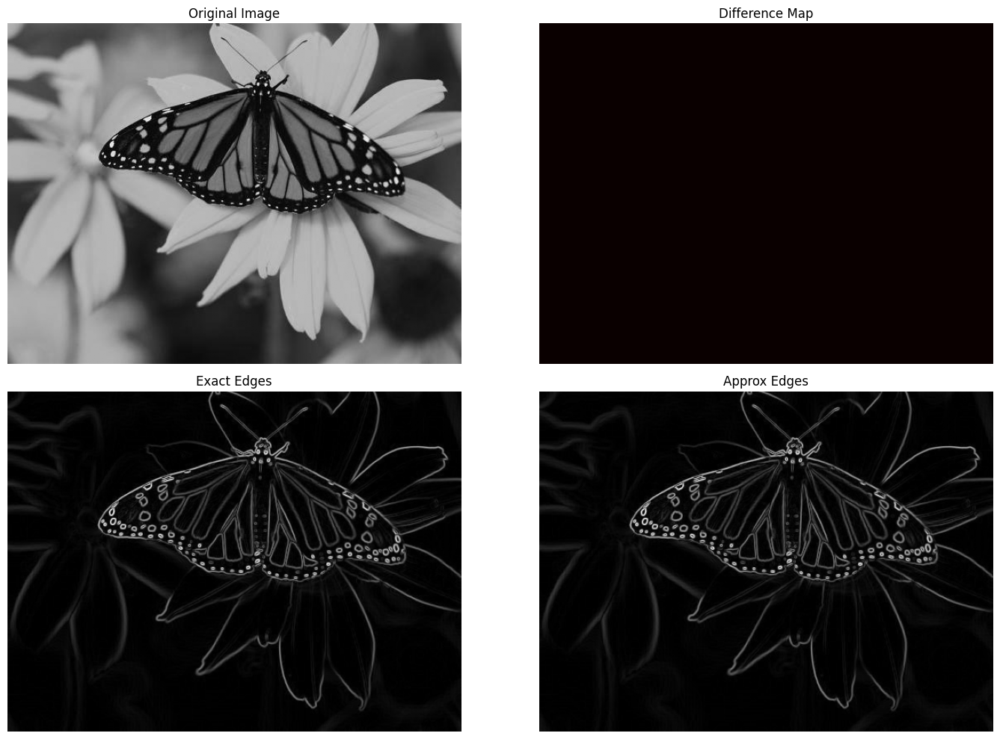

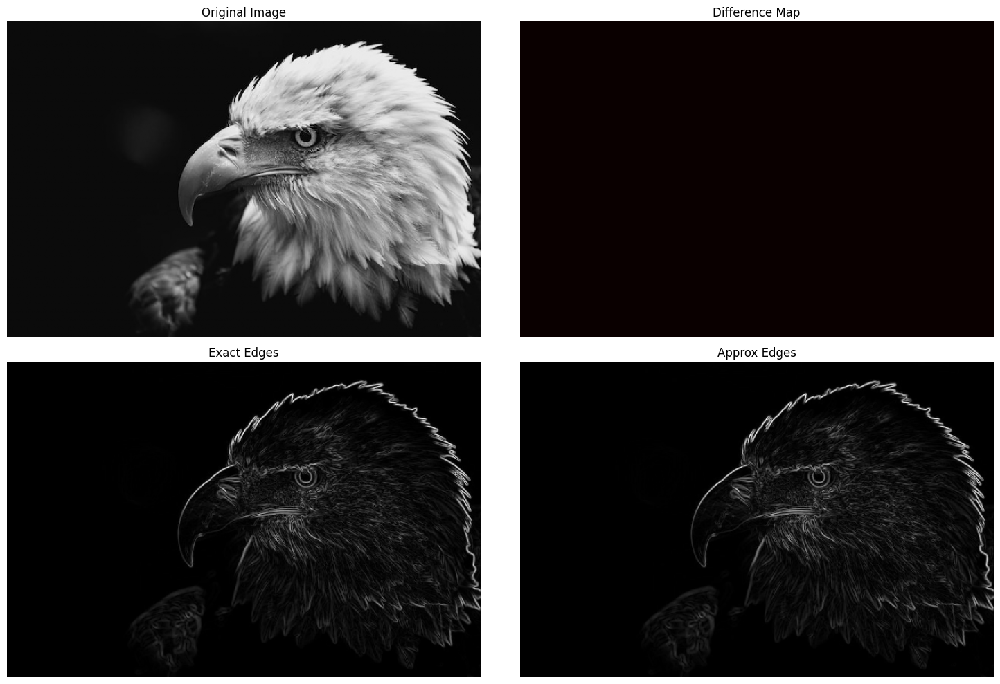

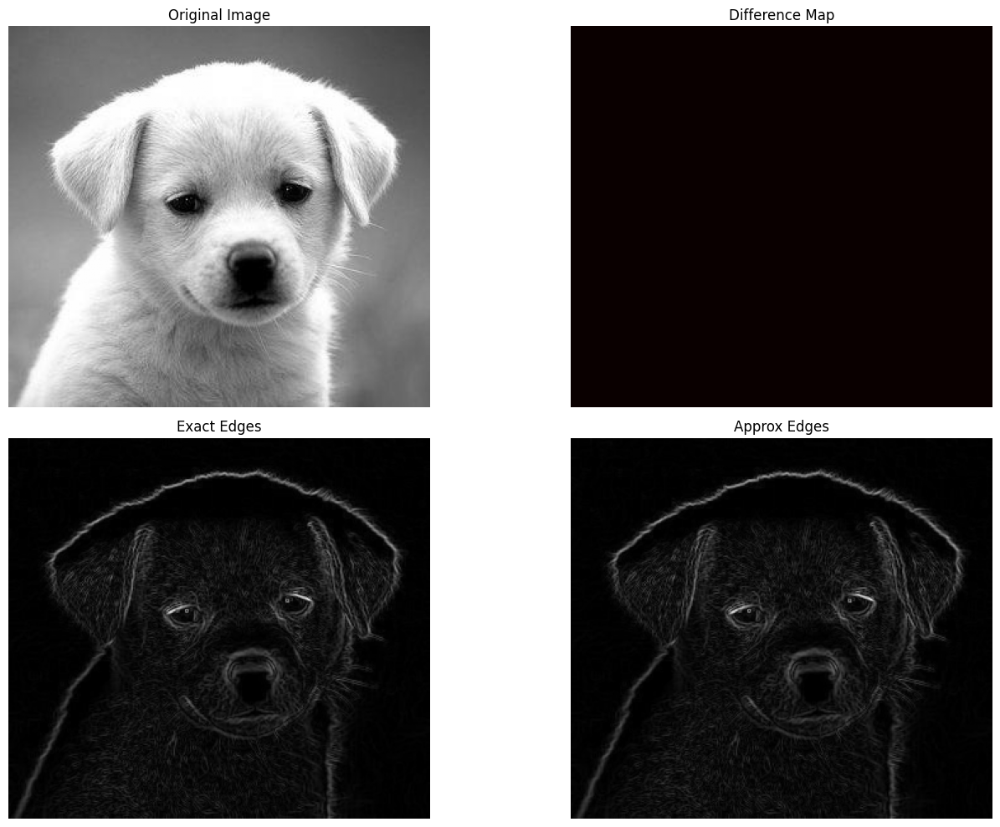

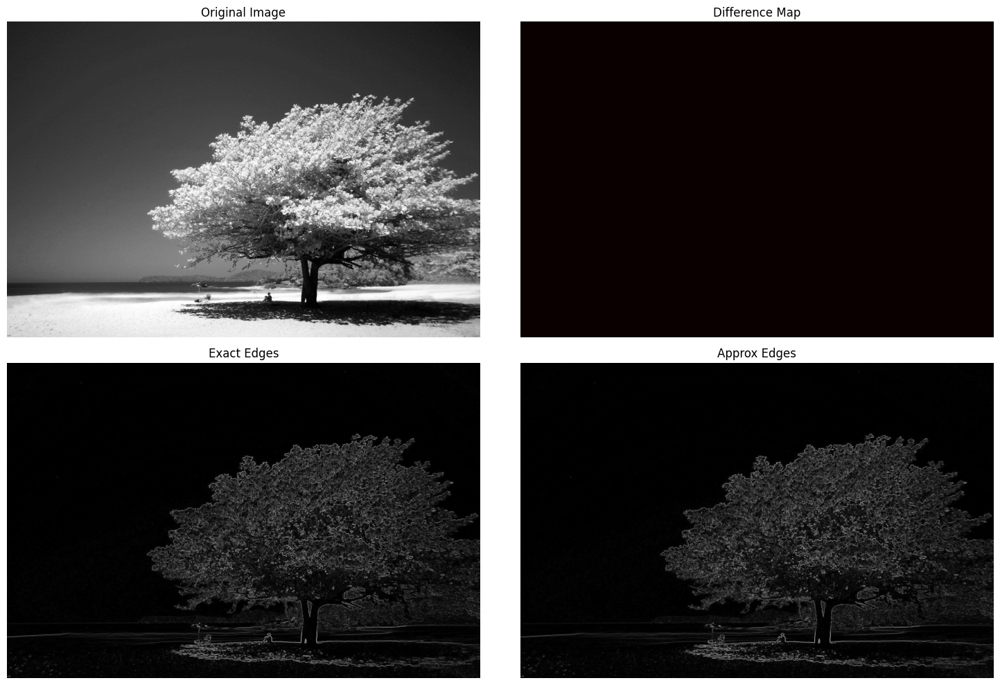

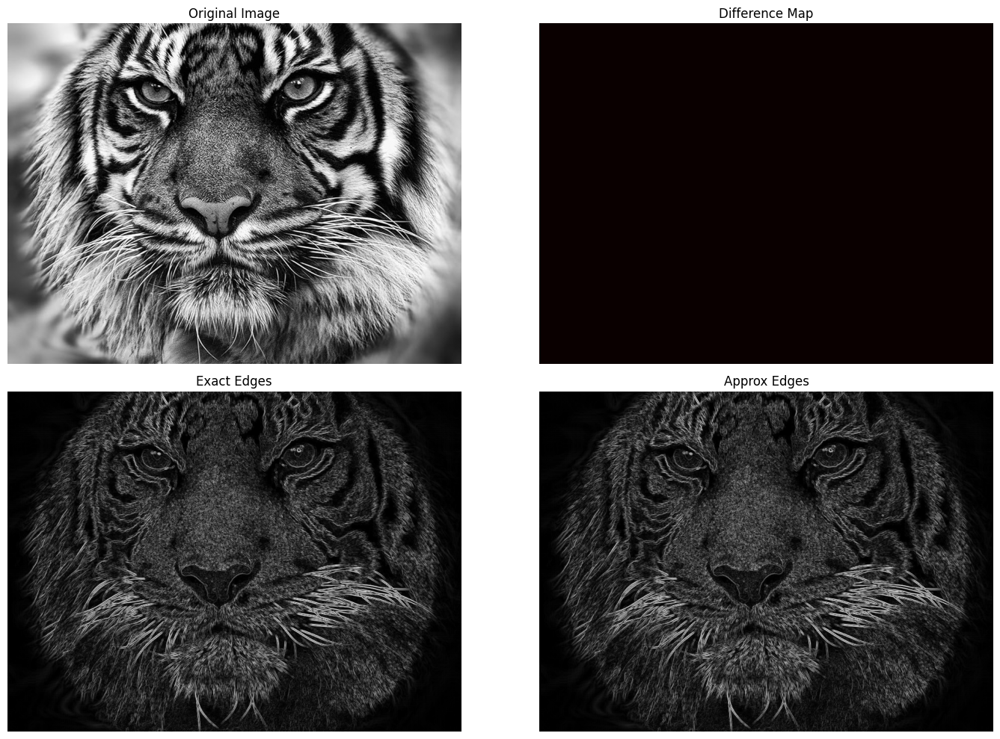



PSNR 	 SSIM
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000
inf dB 	 1.0000

Avg PSNR: inf dB
Min PSNR: inf dB
Max PSNR: inf dB

Avg SSIM: 1.0000
Min SSIM: 1.0000
Max SSIM: 1.0000


In [ ]:
# Sobel operator uses 3*3 kernels for horizontal and vertical gradients
Gx = np.array([[-1, 0, 1],
               [-2, 0, 2],
               [-1, 0, 1]], dtype=np.int32)

Gy = np.array([[-1, -2, -1],
               [ 0,  0,  0],
               [ 1,  2,  1]], dtype=np.int32)

mul2(1, 1)
convolution(np.zeros((3, 3), dtype = np.int32), Gx)

img_1 = cv2.imread('macaw.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_2 = cv2.imread('woman.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_3 = cv2.imread('flower.jpeg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_4 = cv2.imread('apple.jpeg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_5 = cv2.imread('butterfly.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_6 = cv2.imread('eagle.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_7 = cv2.imread('puppy.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_8 = cv2.imread('tree.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_9 = cv2.imread('tiger.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)

images = [img_1, img_2, img_3, img_4, img_5, img_6, img_7, img_8, img_9]
n = len(images)
psnr_val = np.zeros(n)
ssim_val = np.zeros(n)

for i in range (n):
  psnr_val[i], ssim_val[i] = edge_detect(images[i], Gx, Gy)
print("\n")

print("PSNR \t SSIM")
for i in range (n):
  print(f"{psnr_val[i]:.2f} dB \t {ssim_val[i]:.4f}")

print(f"\nAvg PSNR: {np.mean(psnr_val):.2f} dB")
print(f"Min PSNR: {np.min(psnr_val):.2f} dB")
print(f"Max PSNR: {np.max(psnr_val):.2f} dB\n")
print(f"Avg SSIM: {np.mean(ssim_val):.4f}")
print(f"Min SSIM: {np.min(ssim_val):.4f}")
print(f"Max SSIM: {np.max(ssim_val):.4f}")


## Image Smoothing

In [ ]:
def img_smooth(img, K):
  blur_exact, blur_approx = convolution(img, K)

  # Normalization
  blur_exact = blur_exact / 256
  blur_approx = blur_approx >> 8    # divide by 256

  # Clip to [0, 255] and convert to uint8
  blur_exact = np.clip(blur_exact, 0, 255).astype(np.uint8)
  blur_approx = np.clip(blur_approx, 0, 255).astype(np.uint8)

  # Display
  plt.figure(figsize=(15, 10))
  plt.subplot(2, 2, 1)
  plt.imshow(img, cmap = 'gray')
  plt.title("Original Image")
  plt.axis('off')

  plt.subplot(2, 2, 2)
  difference = np.abs(blur_exact.astype(np.float32) - blur_approx.astype(np.float32))
  if(difference.min() != difference.max()):
    diff_normal = (difference - difference.min()) / (difference.max() - difference.min())   # Scale to [0, 1]
  else:
    diff_normal = np.clip(difference, 0, 1)
  plt.imshow(diff_normal, cmap='hot')
  plt.title("Difference Map")
  plt.axis('off')

  plt.subplot(2, 2, 3)
  plt.imshow(blur_exact, cmap='gray')
  plt.title("Exact Blur")
  plt.axis('off')

  plt.subplot(2, 2, 4)
  plt.imshow(blur_approx, cmap='gray')
  plt.title("Approx Blur")
  plt.axis('off')

  plt.tight_layout()
  plt.show()

  # Compute PSNR and SSIM
  psnr_val = psnr(blur_exact, blur_approx, data_range=255)
  ssim_val = ssim(blur_exact, blur_approx, data_range=255)

  return(psnr_val, ssim_val)


### Main Function

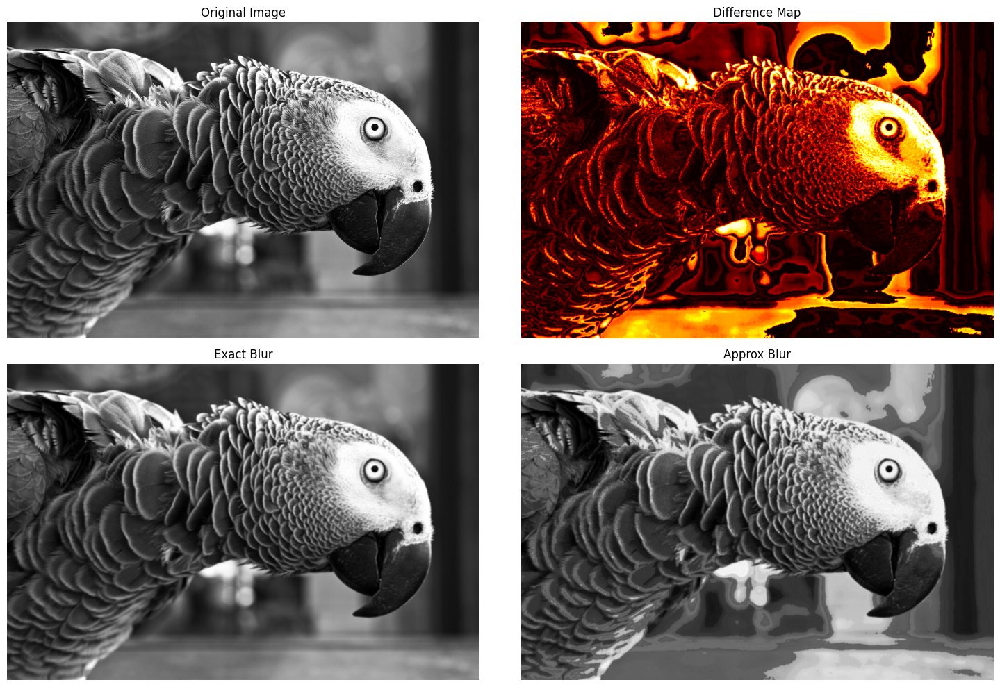

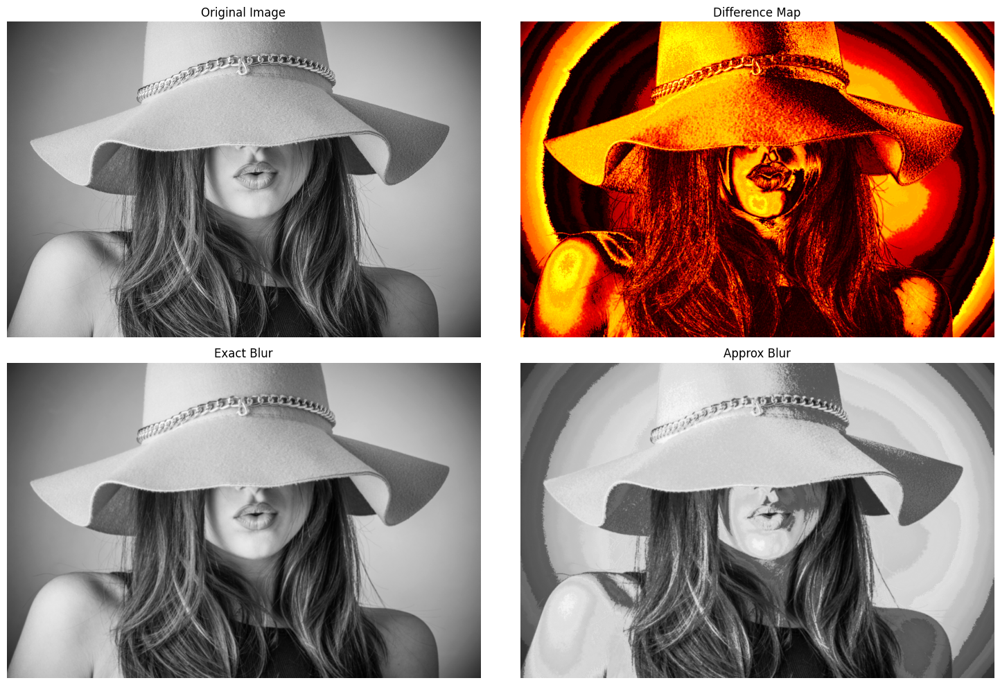

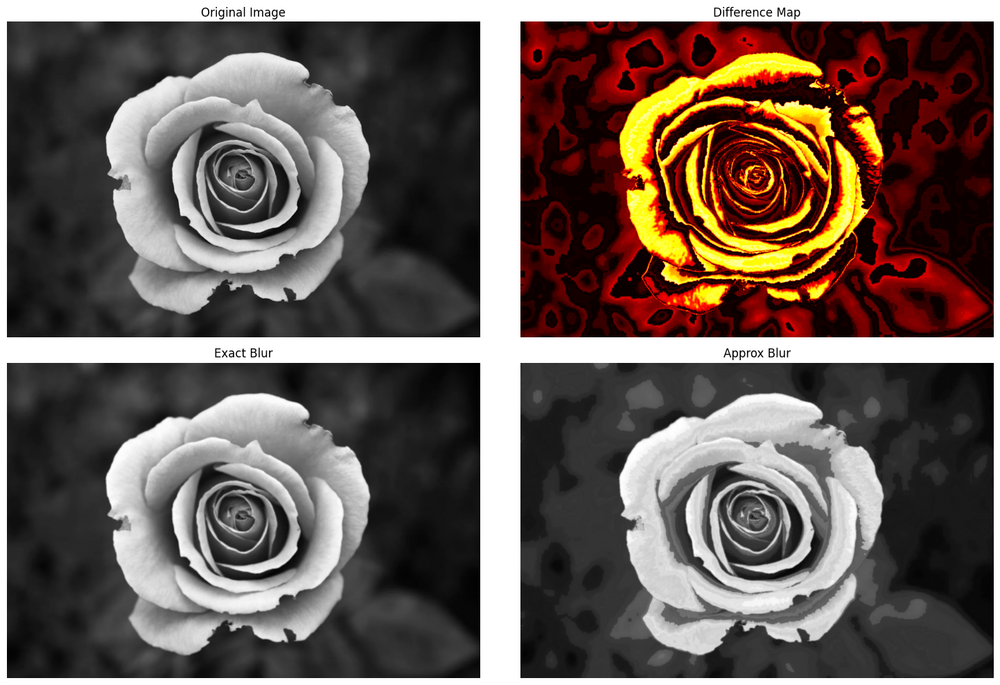

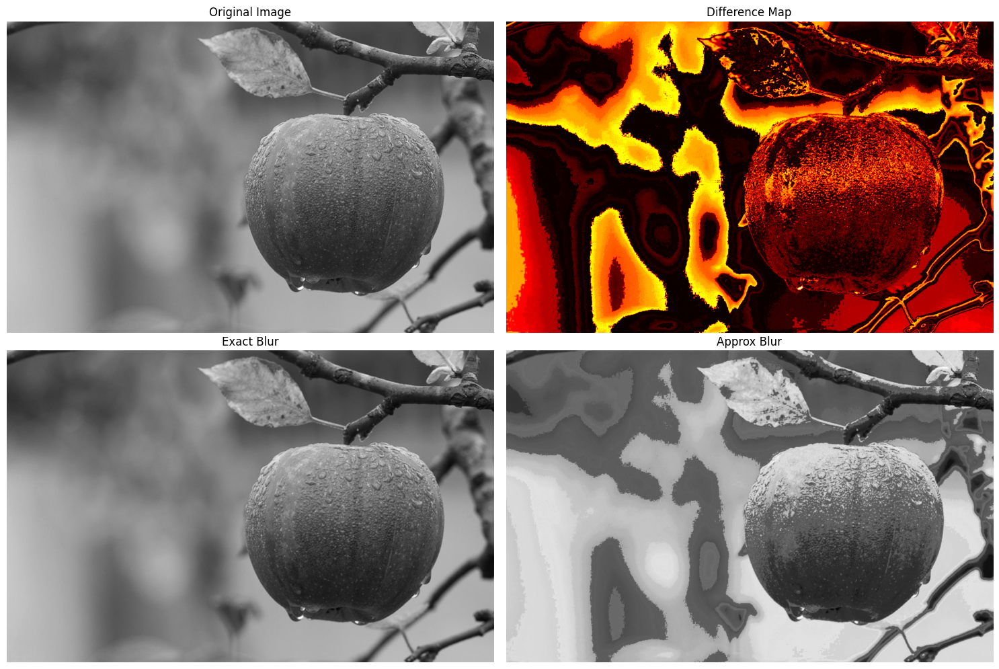

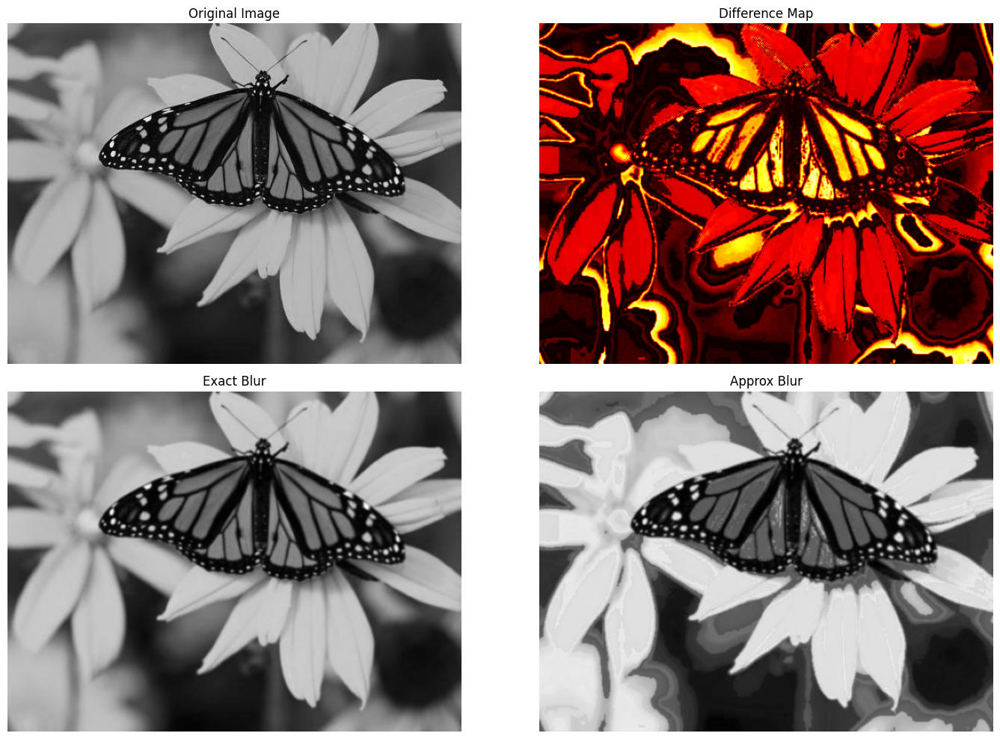

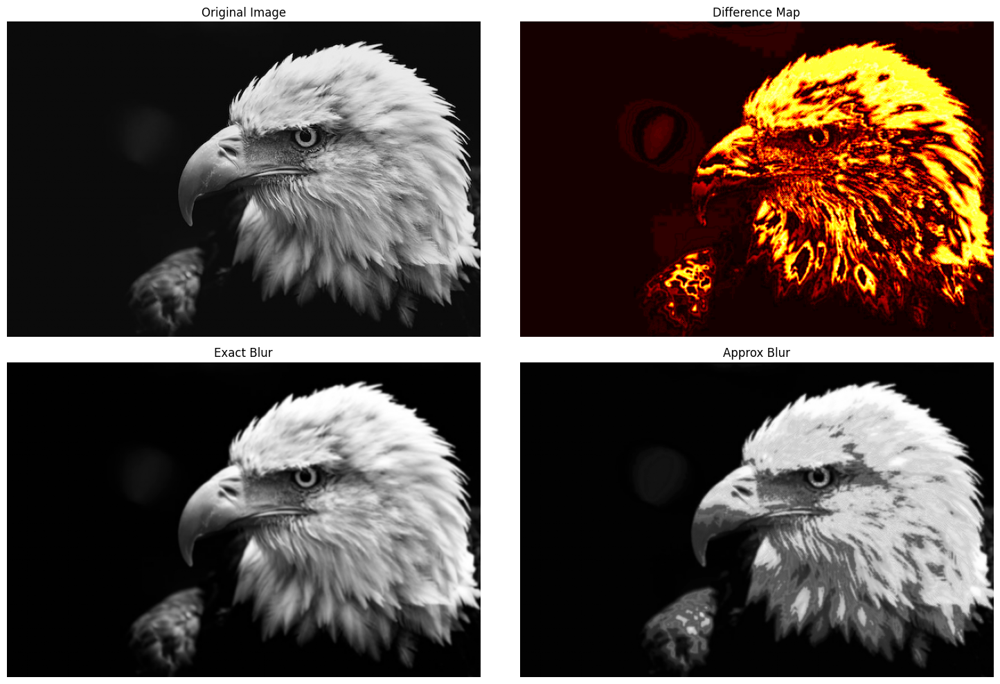

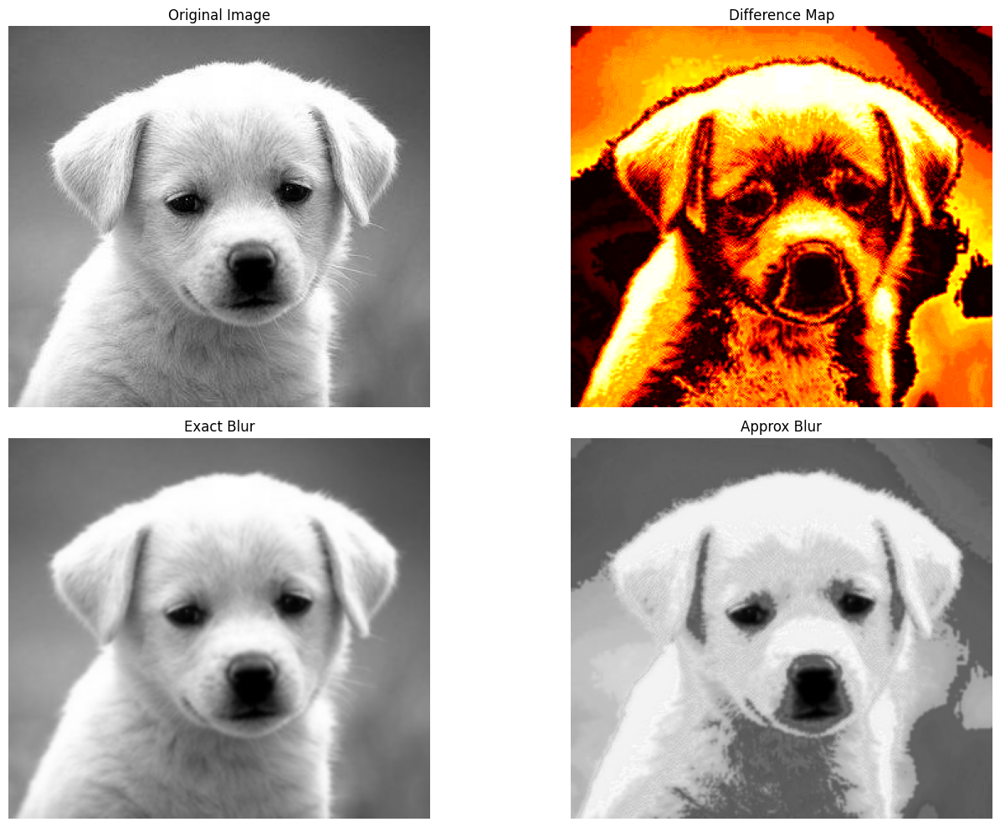

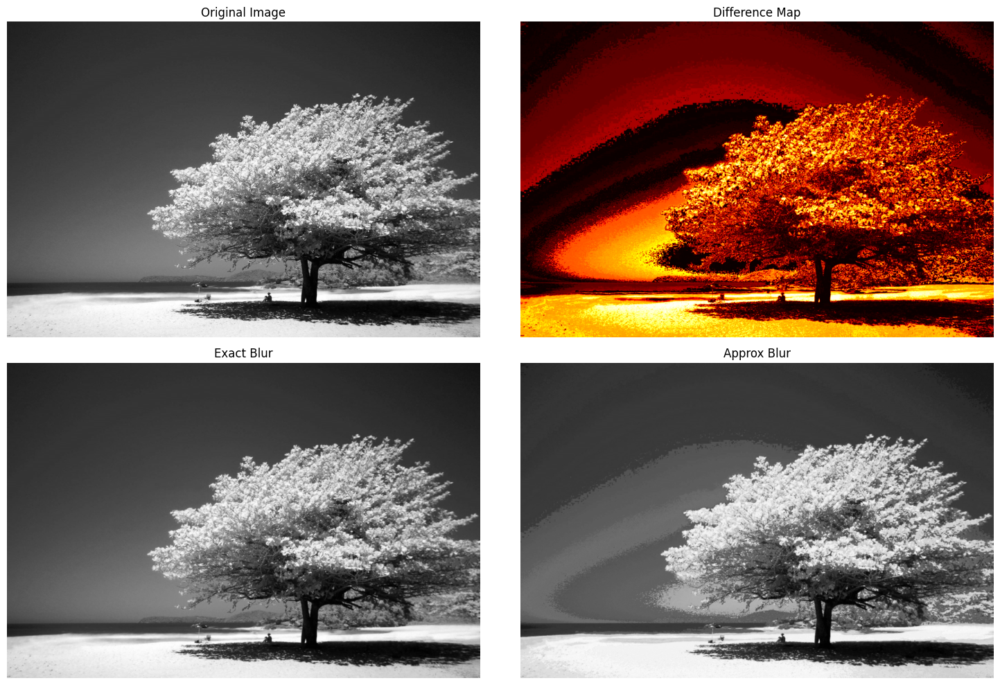

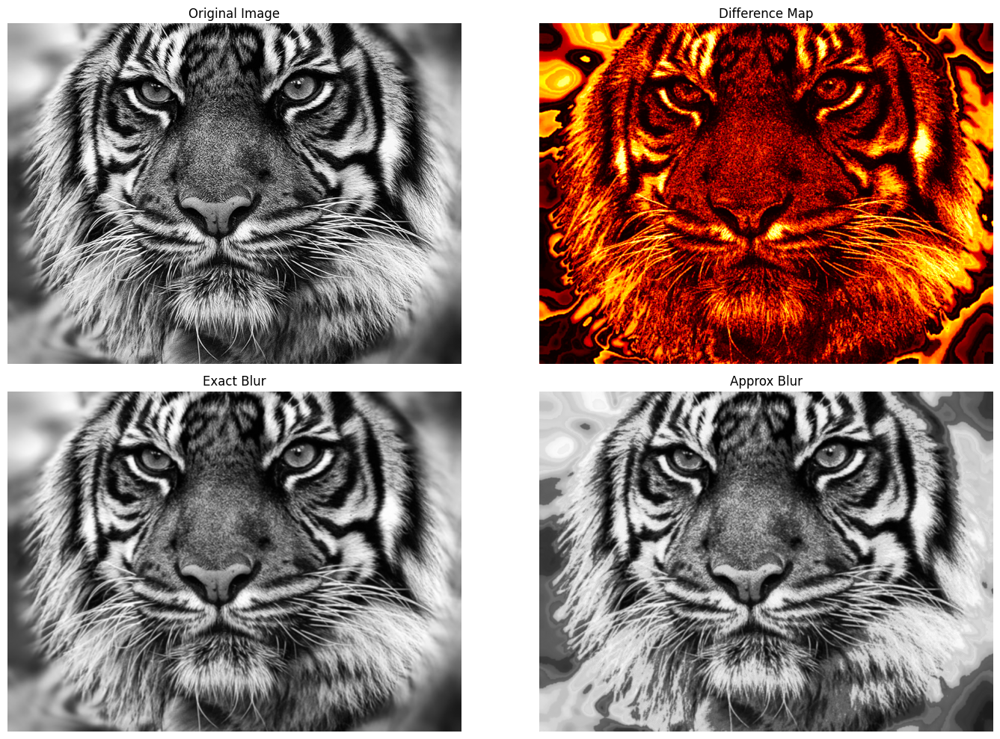



PSNR 	 SSIM
21.89 dB 	 0.8836
20.48 dB 	 0.8451
23.61 dB 	 0.9113
21.59 dB 	 0.8710
24.23 dB 	 0.8737
24.01 dB 	 0.9031
17.22 dB 	 0.7824
20.99 dB 	 0.8903
21.12 dB 	 0.8637

Avg PSNR: 21.68 dB
Min PSNR: 17.22 dB
Max PSNR: 24.23 dB

Avg SSIM: 0.8694
Min SSIM: 0.7824
Max SSIM: 0.9113


In [ ]:
# Gaussian kernel computes weighted averages for smoothing
K = np.array([[1, 4, 6, 4, 1],
              [4, 16, 24, 16, 4],
              [6, 24, 36, 24, 6],
              [4, 16, 24, 16, 4],
              [1, 4, 6, 4, 1]], dtype=np.int32)

mul2(1, 1)
convolution(np.zeros((3, 3), dtype = np.int32), K)

img_1 = cv2.imread('macaw.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_2 = cv2.imread('woman.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_3 = cv2.imread('flower.jpeg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_4 = cv2.imread('apple.jpeg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_5 = cv2.imread('butterfly.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_6 = cv2.imread('eagle.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_7 = cv2.imread('puppy.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_8 = cv2.imread('tree.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_9 = cv2.imread('tiger.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)

images = [img_1, img_2, img_3, img_4, img_5, img_6, img_7, img_8, img_9]
n = len(images)
psnr_val = np.zeros(n)
ssim_val = np.zeros(n)

for i in range (n):
  psnr_val[i], ssim_val[i] = img_smooth(images[i], K)
print("\n")

print("PSNR \t SSIM")
for i in range (n):
  print(f"{psnr_val[i]:.2f} dB \t {ssim_val[i]:.4f}")

print(f"\nAvg PSNR: {np.mean(psnr_val):.2f} dB")
print(f"Min PSNR: {np.min(psnr_val):.2f} dB")
print(f"Max PSNR: {np.max(psnr_val):.2f} dB\n")
print(f"Avg SSIM: {np.mean(ssim_val):.4f}")
print(f"Min SSIM: {np.min(ssim_val):.4f}")
print(f"Max SSIM: {np.max(ssim_val):.4f}")


## Image Multiplication

### Grayscale

In [ ]:
def img_mul1(img_1, img_2, plot):
  assert img_1.shape == img_2.shape   # Check dimensions

  img_1_float = img_1.astype(np.float32)
  img_2_float = img_2.astype(np.float32)
  approx_result = np.zeros_like(img_1)
  exact_result = np.zeros_like(img_1_float)
  # exact_result = cv2.multiply(img_1, img_2, scale=1/255.0)

  for i in range (img_1.shape[0]):
    for j in range (img_1.shape[1]):
      approx_result[i, j] = mul2(img_1[i, j], img_2[i, j])
      exact_result[i, j] = img_1_float[i, j] * img_2_float[i, j] / 255.0

  # Normalize to [0, 255] for display
  approx_result = np.clip(approx_result / 255.0, 0, 255).astype(np.uint8)
  exact_result = np.clip(exact_result, 0, 255).astype(np.uint8)

  if(plot):
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    plt.imshow(img_1, cmap = 'gray')
    plt.title("Image 1")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(img_2, cmap = 'gray')
    plt.title("Image 2")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(exact_result, cmap = 'gray')
    plt.title("Multiplied Image (Exact)")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(approx_result, cmap = 'gray')
    plt.title("Multiplied Image (Approx)")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

  psnr_val = psnr(exact_result, approx_result, data_range=255)
  ssim_val = ssim(exact_result, approx_result, data_range=255)

  return(psnr_val, ssim_val)


#### Scaling

In [ ]:
def img_mul2(img, factor, plot):
  img_float = img.astype(np.float32)
  approx_result = np.zeros_like(img, dtype = np.int32)
  exact_result = np.zeros_like(img_float)

  for i in range (img.shape[0]):
    for j in range (img.shape[1]):
      approx_result[i, j] = mul2(img[i, j], factor)
      exact_result[i, j] = img_float[i, j] * factor / 10.0

  # Normalize to [0, 255] for display
  approx_result = np.clip(approx_result // 10, 0, 255).astype(np.uint8)
  exact_result = np.clip(exact_result, 0, 255).astype(np.uint8)

  if(plot):
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    plt.imshow(img, cmap = 'gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(exact_result, cmap = 'gray')
    plt.title("Scaled Image (Exact)")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(approx_result, cmap = 'gray')
    plt.title("Scaled Image (Approx)")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

  psnr_val = psnr(exact_result, approx_result, data_range=255)
  ssim_val = ssim(exact_result, approx_result, data_range=255)

  return(psnr_val, ssim_val)


#### Main Function

In [ ]:
img_1 = cv2.imread('macaw_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_2 = cv2.imread('woman_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_3 = cv2.imread('flower_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_4 = cv2.imread('apple_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_5 = cv2.imread('butterfly_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_6 = cv2.imread('eagle_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_7 = cv2.imread('puppy_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_8 = cv2.imread('tree_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)
img_9 = cv2.imread('tiger_resized.jpg', cv2.IMREAD_GRAYSCALE).astype(np.int32)

images = [img_1, img_2, img_3, img_4, img_5, img_6, img_7, img_8, img_9]
n = len(images)
psnr_val = []
ssim_val = []

for i in range (n):
  for j in range (n):
    if i != j:
      p, s = img_mul1(images[i], images[j], 0)
      psnr_val.append(p)
      ssim_val.append(s)

print("\nPSNR \t\t SSIM")
for i in range (len(psnr_val)):
  print(f"{psnr_val[i]:.2f} dB \t {ssim_val[i]:.4f}")

print(f"\nAvg PSNR: {np.mean(psnr_val):.2f} dB")
print(f"Min PSNR: {np.min(psnr_val):.2f} dB")
print(f"Max PSNR: {np.max(psnr_val):.2f} dB\n")
print(f"Avg SSIM: {np.mean(ssim_val):.4f}")
print(f"Min SSIM: {np.min(ssim_val):.4f}")
print(f"Max SSIM: {np.max(ssim_val):.4f}")



PSNR 		 SSIM
28.19 dB 	 0.8733
29.37 dB 	 0.8763
32.38 dB 	 0.9127
32.34 dB 	 0.9160
30.17 dB 	 0.9381
26.01 dB 	 0.8521
25.98 dB 	 0.8354
28.60 dB 	 0.8824
26.88 dB 	 0.8251
27.45 dB 	 0.8210
29.33 dB 	 0.8753
29.05 dB 	 0.8666
31.00 dB 	 0.9145
26.34 dB 	 0.8266
24.84 dB 	 0.7888
27.31 dB 	 0.8796
30.60 dB 	 0.8976
29.36 dB 	 0.8849
32.51 dB 	 0.9140
30.19 dB 	 0.9104
32.47 dB 	 0.9309
27.39 dB 	 0.8558
27.71 dB 	 0.8731
30.27 dB 	 0.9105
28.47 dB 	 0.8576
26.77 dB 	 0.8481
28.64 dB 	 0.8606
32.28 dB 	 0.9009
30.63 dB 	 0.9208
24.48 dB 	 0.8240
27.13 dB 	 0.8271
27.17 dB 	 0.8636
29.87 dB 	 0.8841
28.69 dB 	 0.8713
30.55 dB 	 0.8844
32.18 dB 	 0.8978
32.36 dB 	 0.9320
26.70 dB 	 0.8490
28.55 dB 	 0.8673
29.58 dB 	 0.9033
31.97 dB 	 0.9340
30.48 dB 	 0.9106
31.04 dB 	 0.9071
33.20 dB 	 0.9319
31.19 dB 	 0.9286
29.49 dB 	 0.9059
27.88 dB 	 0.8902
30.88 dB 	 0.9362
25.64 dB 	 0.8165
24.37 dB 	 0.8050
25.23 dB 	 0.7713
29.39 dB 	 0.8674
29.03 dB 	 0.8491
26.70 dB 	 0.8877
22.92 dB 	 0.7

### RGB

In [ ]:
def img_mul1(img_1, img_2, plot):
  assert img_1.shape == img_2.shape   # Check dimensions

  img_1_float = img_1.astype(np.float32)
  img_2_float = img_2.astype(np.float32)
  approx_result = np.zeros_like(img_1)
  exact_result = np.zeros_like(img_1_float)
  # exact_result = cv2.multiply(img_1, img_2, scale=1/255.0)

  for c in range (3):
    for i in range (img_1.shape[0]):
      for j in range (img_1.shape[1]):
        approx_result[i, j, c] = mul2(img_1[i, j, c], img_2[i, j, c])
        exact_result[i, j, c] = img_1_float[i, j, c] * img_2_float[i, j, c] / 255.0

  # Normalize to [0, 255] for display
  approx_result = np.clip(approx_result / 255.0, 0, 255).astype(np.uint8)
  exact_result = np.clip(exact_result, 0, 255).astype(np.uint8)

  img1_rbg = cv2.cvtColor(img_1.astype(np.uint8), cv2.COLOR_BGR2RGB)
  img2_rbg = cv2.cvtColor(img_2.astype(np.uint8), cv2.COLOR_BGR2RGB)
  exact_rbg = cv2.cvtColor(exact_result.astype(np.uint8), cv2.COLOR_BGR2RGB)
  approx_rbg = cv2.cvtColor(approx_result.astype(np.uint8), cv2.COLOR_BGR2RGB)

  if(plot):
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    plt.imshow(img1_rbg)
    plt.title("Image 1")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(img2_rbg)
    plt.title("Image 2")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(exact_rbg)
    plt.title("Multiplied Image (Exact)")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(approx_rbg)
    plt.title("Multiplied Image (Approx)")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

  psnr_val = psnr(exact_result, approx_result, data_range=255)
  ssim_val = ssim(exact_result, approx_result, data_range=255, channel_axis=2)

  return(psnr_val, ssim_val)


#### Scaling

In [ ]:
def img_mul2(img, factor, plot):
  img_float = img.astype(np.float32)
  approx_result = np.zeros_like(img, dtype = np.int32)
  exact_result = np.zeros_like(img_float)

  for c in range (3):                # 0- Blue, 1- Green, 2- Red
    for i in range (img.shape[0]):
      for j in range (img.shape[1]):
        approx_result[i, j, c] = mul2(img[i, j, c], factor[c])
        exact_result[i, j, c] = img_float[i, j, c] * factor[c] / 10.0

  # Normalize to [0, 255] for display
  approx_result = np.clip(approx_result // 10, 0, 255).astype(np.uint8)
  exact_result = np.clip(exact_result, 0, 255).astype(np.uint8)

  img_rbg = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_BGR2RGB)
  exact_rbg = cv2.cvtColor(exact_result.astype(np.uint8), cv2.COLOR_BGR2RGB)
  approx_rbg = cv2.cvtColor(approx_result.astype(np.uint8), cv2.COLOR_BGR2RGB)

  if(plot):
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    plt.imshow(img_rbg)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(exact_rbg)
    plt.title("Scaled Image (Exact)")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(approx_rbg)
    plt.title("Scaled Image (Approx)")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

  psnr_val = psnr(exact_result, approx_result, data_range=255)
  ssim_val = ssim(exact_result, approx_result, data_range=255, channel_axis=2)

  return(psnr_val, ssim_val)


#### Main Function

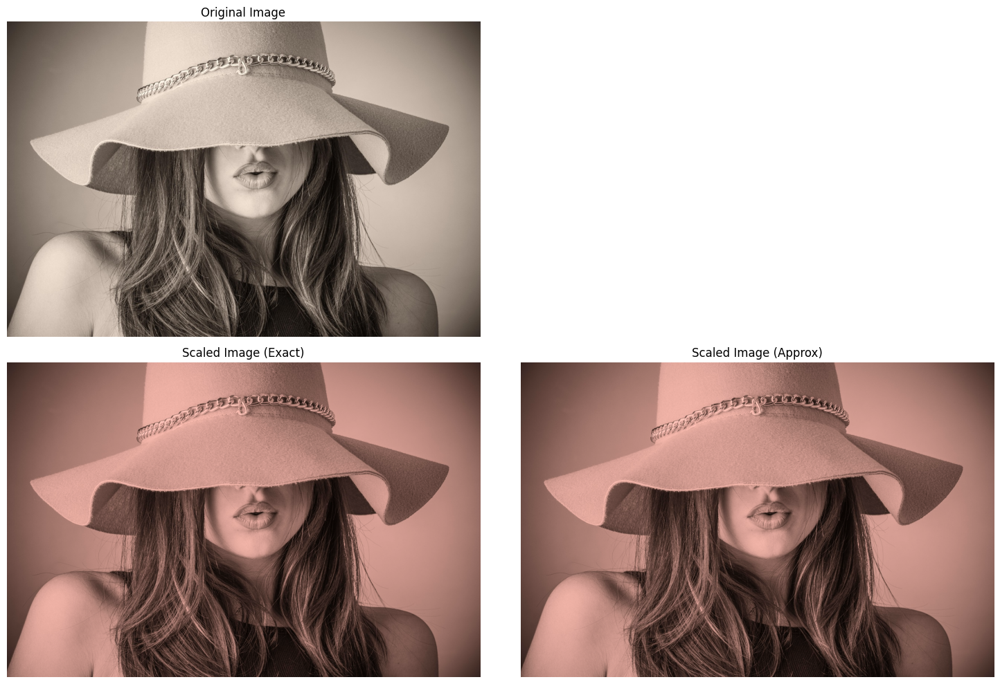

/usr/local/lib/python3.11/dist-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in scalar divide
  return 10 * np.log10((data_range**2) / err)



PSNR: inf	SSIM: 1.0000


In [ ]:
img_1 = cv2.imread('lake_resized.jpg').astype(np.int32)
img_2 = cv2.imread('house_resized.jpg').astype(np.int32)
img_3 = cv2.imread('woman.jpg').astype(np.int32)
img_4 = cv2.imread('sky_resized.jpg').astype(np.int32)
img_5 = cv2.imread('landscape_resized.jpg').astype(np.int32)

psnr_val, ssim_val = img_mul2(img_3, [8.0, 8.0, 10.0], 1)
print(f"\nPSNR: {psnr_val:.2f}\tSSIM: {ssim_val:.4f}")
